# **Import relevant libraries**

In [ ]:
#import the library
import nltk
from collections import Counter
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
import re
from collections import Counter
import string
from nltk.corpus import twitter_samples
from nltk.tokenize import RegexpTokenizer
from sklearn.feature_extraction.text import CountVectorizer
import pandas as pd
import string
import matplotlib.pyplot as plt
from nltk import pos_tag

In [ ]:
# Download necessary NLTK resources
nltk.download('twitter_samples')
nltk.download('punkt') # For tokenization
nltk.download('stopwords')  # For stopword removal
nltk.download('wordnet')  # For lemmatization
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package twitter_samples to /root/nltk_data...
[nltk_data]   Package twitter_samples is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

# **1. Load the Dataset and perform EDA - also show Graphical Visualization**

## **1.1 Counting the number of positive, negative, and neutral tweets**

In [ ]:
# Load positive, negative tweets, neutral tweets
positive_tweets = twitter_samples.strings('positive_tweets.json')
negative_tweets = twitter_samples.strings('negative_tweets.json')
neutral_tweets = twitter_samples.strings('tweets.20150430-223406.json')  # neutral dataset in twitter_samples

In [ ]:
# Count the number of tweets in each category
positive_count = len(positive_tweets)
negative_count = len(negative_tweets)
neutral_count = len(neutral_tweets)

In [ ]:
# Print the results
print(f"Count of positive tweets: {positive_count}")
print(f"Count of negative tweets: {negative_count}")
print(f"Count of neutral tweets: {neutral_count}")

Count of positive tweets: 5000
Count of negative tweets: 5000
Count of neutral tweets: 20000


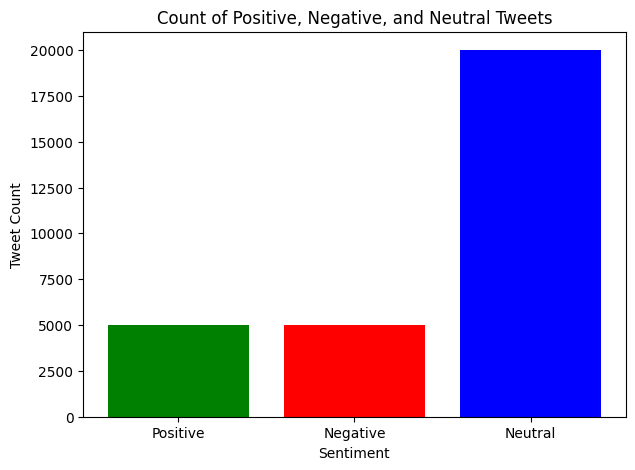

In [ ]:
# Data for the visualization
categories = ['Positive', 'Negative', 'Neutral']
counts = [positive_count, negative_count, neutral_count]
colors = ['green', 'red', 'blue']

# Create the bar chart
plt.figure(figsize=(7, 5))
plt.bar(categories, counts, color=colors)

# Add labels and title
plt.xlabel('Sentiment')
plt.ylabel('Tweet Count')
plt.title('Count of Positive, Negative, and Neutral Tweets')

# Display the chart
plt.show()

## **1.2 The frequency of words in positive, negative and neutral and Top 10 common words category**

- to find the words specifically we have to apply stopwords, punctuation, lemmatizer, remove urls, hashtags, mentions

In [ ]:
# Combine all tweets into categories for analysis
all_tweets = {
    "Positive": positive_tweets,
    "Negative": negative_tweets,
    "Neutral": neutral_tweets
}

In [ ]:
# Load English stopwords and add punctuation
stop_words = set(stopwords.words('english'))
stop_words.update(string.punctuation)

# Initialize lemmatizer
lemmatizer = WordNetLemmatizer()

# Function to remove URLs, mentions, and hashtags from the tweets
def clean_tweet(tweet):
    tweet = re.sub(r"http\S+|www\S+|https\S+", '', tweet, flags=re.MULTILINE)  # Remove URLs
    tweet = re.sub(r"@\w+", '', tweet)  # Remove @mentions
    tweet = re.sub(r"#\w+", '', tweet)  # Remove hashtags
    return tweet

# Function to preprocess tweets: tokenize, remove stopwords, lemmatize, and return word frequencies
def preprocess_and_get_freq(tweets):
    all_words = []

    for tweet in tweets:
        tweet = clean_tweet(tweet)  # Remove URLs, mentions, and hashtags
        words = word_tokenize(tweet.lower())  # Tokenize and convert to lowercase
        filtered_words = [
            lemmatizer.lemmatize(word) for word in words if word.isalpha() and word not in stop_words
        ]  # Remove stopwords, punctuation, and apply lemmatization
        all_words.extend(filtered_words)

    # Calculate the frequency distribution of words
    word_freq = Counter(all_words)

    return word_freq


In [ ]:
for category, tweets in all_tweets.items():
    word_freq = preprocess_and_get_freq(tweets)
    common_words = word_freq.most_common(10)

    print(f"\nTop 10 most common words in {category} tweets:")
    for word, freq in common_words:
        print(f"{word}: {freq}")


Top 10 most common words in Positive tweets:
thanks: 393
u: 361
love: 323
follow: 303
thank: 246
day: 242
good: 234
like: 223
happy: 191
amp: 174

Top 10 most common words in Negative tweets:
please: 274
miss: 243
u: 232
want: 226
like: 211
get: 189
ca: 180
na: 176
time: 162
day: 150

Top 10 most common words in Neutral tweets:
rt: 13538
tory: 5769
miliband: 5560
snp: 4605
ed: 2842
labour: 2733
cameron: 2635
farage: 1899
ukip: 1827
david: 1698


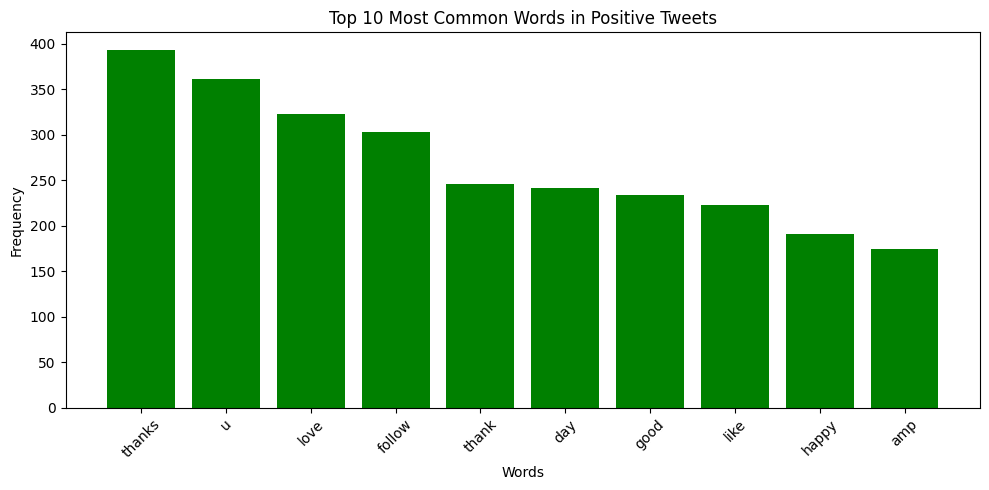

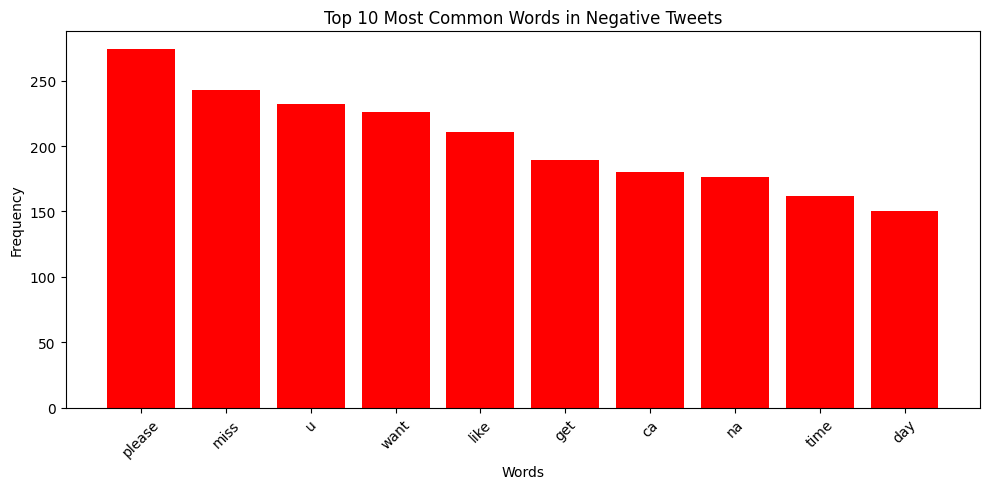

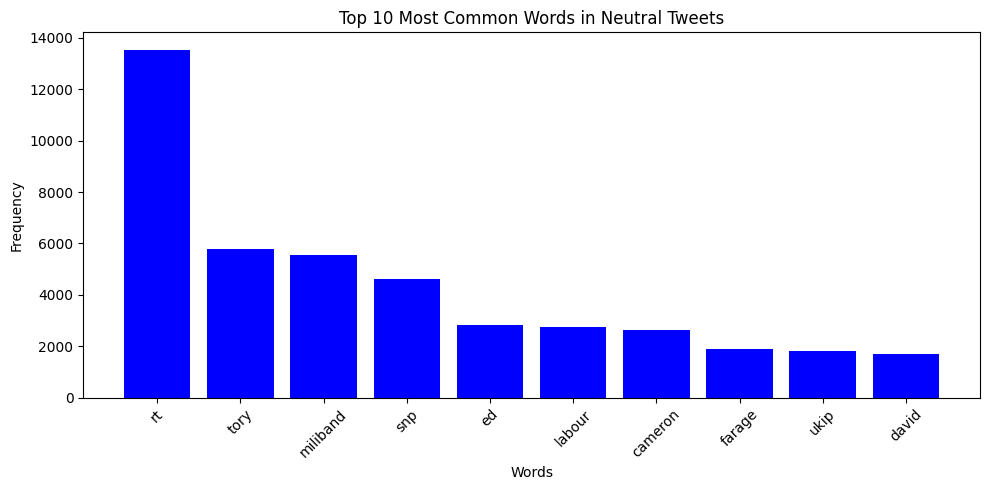

In [ ]:
import matplotlib.pyplot as plt

# Assuming the word frequencies for each category are already calculated using your existing code
colors = {
    "Positive": "green",
    "Negative": "red",
    "Neutral": "blue"
}

for category, tweets in all_tweets.items():
    word_freq = preprocess_and_get_freq(tweets)  # Preprocess and get word frequency
    common_words = word_freq.most_common(10)     # Get the top 10 most common words

    # Unpack the words and their frequencies for plotting
    words, frequencies = zip(*common_words)

    # Create the bar chart for each category
    plt.figure(figsize=(10, 5))
    plt.bar(words, frequencies, color=colors[category])  # Apply the corresponding color

    # Add labels and title
    plt.xlabel('Words')
    plt.ylabel('Frequency')
    plt.title(f"Top 10 Most Common Words in {category} Tweets")

    # Rotate the x-axis labels for better readability
    plt.xticks(rotation=45)

    # Display the chart
    plt.tight_layout()
    plt.show()


## **1.3 Frequency of hashtags in positive,negative and neutral tweets and Top 10 most common hashtags**

In [ ]:
 # Function to extract hashtags from tweets
def extract_hashtags(tweets):
    hashtags = []

    for tweet in tweets:
        # Use regex to find all hashtags (words starting with #)
        hashtags_in_tweet = re.findall(r"#\w+", tweet)  # Extract hashtags
        hashtags.extend(hashtags_in_tweet)  # Add hashtags to the list

    # Calculate the frequency distribution of hashtags
    hashtag_freq = Counter(hashtags)

    return hashtag_freq

In [ ]:
# Calculate and print top 10 common hashtags for each category
for category, tweets in all_tweets.items():
    hashtag_freq = extract_hashtags(tweets)
    common_hashtags = hashtag_freq.most_common(10)

    print(f"\nTop 10 most common hashtags in {category} tweets:")
    for hashtag, freq in common_hashtags:
        print(f"{hashtag}: {freq}")


Top 10 most common hashtags in Positive tweets:
#FF: 31
#FollowFriday: 25
#FlipkartFashionFriday: 17
#snapchat: 17
#ff: 15
#WSaleLove: 14
#retweet: 13
#kik: 12
#BrainDots: 11
#CEO1Month: 11

Top 10 most common hashtags in Negative tweets:
#snapchat: 38
#kik: 35
#ZaynIsComingBackOnJuly26: 23
#hornykik: 17
#UberIceCream: 14
#kikhorny: 13
#kikgirl: 13
#UniteBlue: 10
#indiemusic: 10
#Tcot: 9

Top 10 most common hashtags in Neutral tweets:
#bbcqt: 2106
#AskNigelFarage: 1168
#UKIP: 951
#GE2015: 626
#SNP: 616
#BBCQT: 240
#AskFarage: 210
#BBCqt: 202
#Labour: 195
#VoteSNP: 188


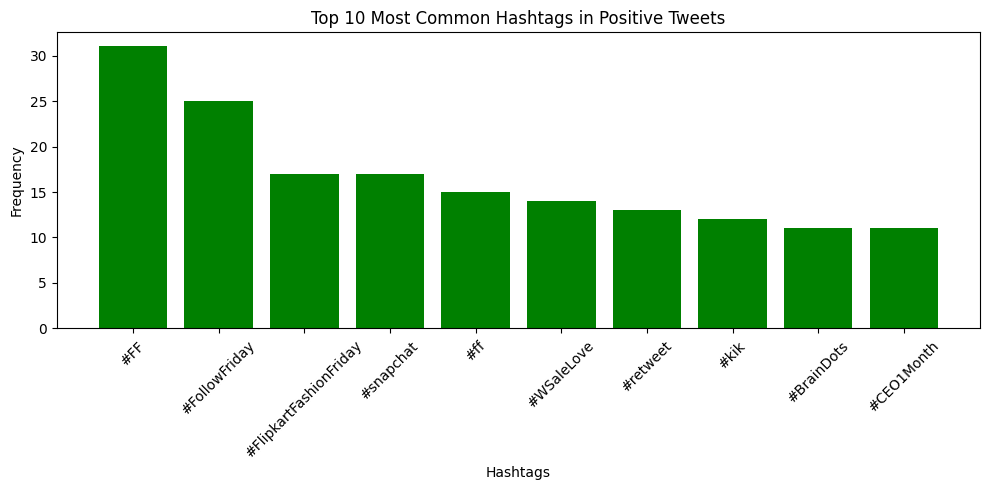

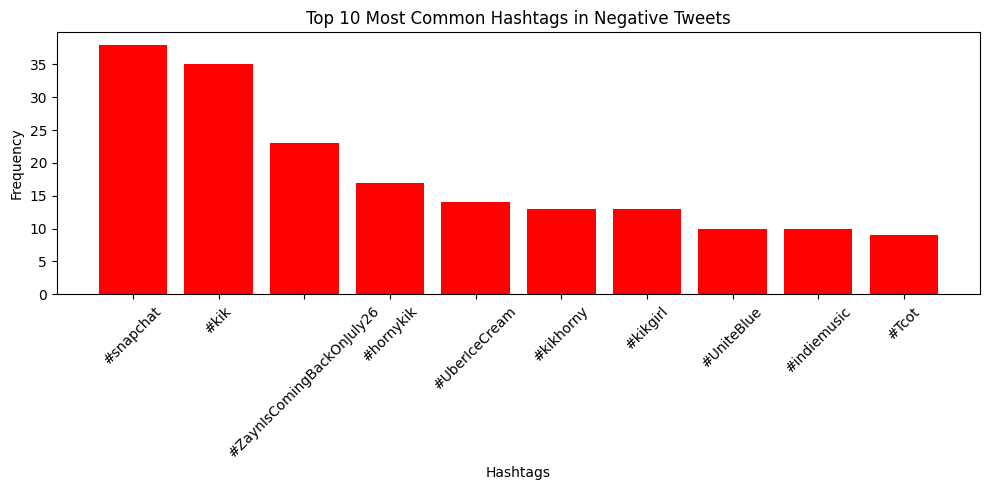

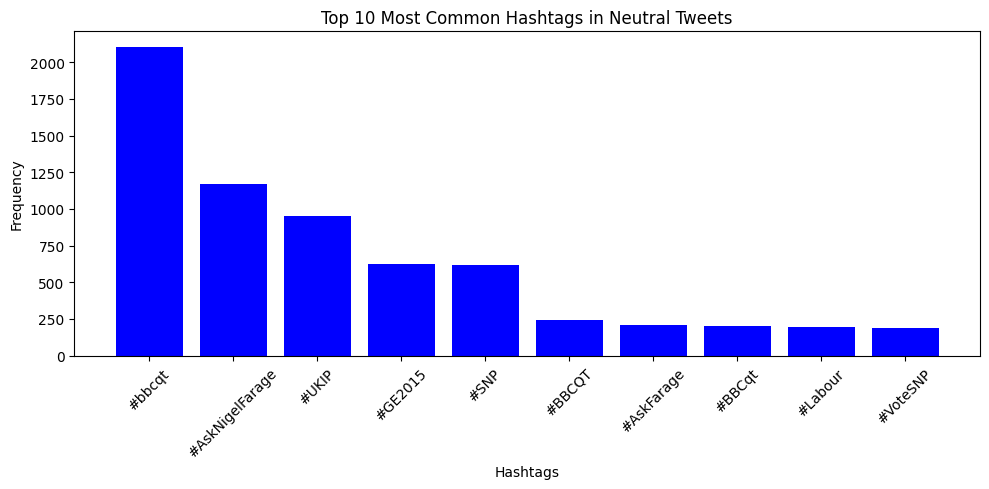

In [ ]:
# Assuming the function extract_hashtags(tweets) returns the frequency distribution of hashtags
# and the all_tweets dictionary contains the tweets for each category

colors = {
    "Positive": "green",
    "Negative": "red",
    "Neutral": "blue"
}

# Calculate and visualize top 10 common hashtags for each category
for category, tweets in all_tweets.items():
    hashtag_freq = extract_hashtags(tweets)  # Function to extract hashtags and calculate frequency
    common_hashtags = hashtag_freq.most_common(10)  # Get the top 10 most common hashtags

    # Unpack the hashtags and their frequencies for plotting
    hashtags, frequencies = zip(*common_hashtags)

    # Create the bar chart for each category
    plt.figure(figsize=(10, 5))
    plt.bar(hashtags, frequencies, color=colors[category])  # Apply the corresponding color

    # Add labels and title
    plt.xlabel('Hashtags')
    plt.ylabel('Frequency')
    plt.title(f"Top 10 Most Common Hashtags in {category} Tweets")

    # Rotate the x-axis labels for better readability
    plt.xticks(rotation=45)

    # Display the chart
    plt.tight_layout()
    plt.show()


## **1.4 Frequency of retweets in positive, negative and neutral tweets and Top 10 most common retweets counts in each category**

In [ ]:
# Function to extract retweets from tweets
def extract_retweets(tweets):
    retweets = []

    for tweet in tweets:
        # Identify retweets starting with "RT @username:"
        if tweet.startswith("RT @"):
            retweets.append(tweet)

    # Calculate the frequency distribution of retweets
    retweet_freq = Counter(retweets)

    return retweet_freq

In [ ]:
# Calculate and print top 10 common retweets for each category
for category, tweets in all_tweets.items():
    retweet_freq = extract_retweets(tweets)
    common_retweets = retweet_freq.most_common(10)

    print(f"\nTop 10 most common retweets in {category} tweets:")

    # Check if there are any retweets, if not, print a message
    if len(common_retweets) == 0:
        print(f"No retweets found in {category} tweets.\n")
    else:
        for retweet, freq in common_retweets:
            print(f"Retweet: {retweet} \nCount: {freq}\n")


Top 10 most common retweets in Positive tweets:
No retweets found in Positive tweets.


Top 10 most common retweets in Negative tweets:
No retweets found in Negative tweets.


Top 10 most common retweets in Neutral tweets:
Retweet: RT @Tommy_Colc: Financial Times come out in support of Tories claiming Miliband is "preoccupied w/ inequality". The man who wrote it http:/… 
Count: 491

Retweet: RT @NicolaSturgeon: If Miliband is going to let Tories in rather than work with SNP, we will definitely need lots of SNP MPs to protect Sco… 
Count: 430

Retweet: RT @Tommy_Colc: FT come out in support of Tories claiming Miliband is "preoccupied w/ inequality". The man who wrote it @sturdyAlex http://… 
Count: 131

Retweet: RT @thomasmessenger: For all Tories claiming that Labour overspent and thus caused a global financial crisis, ahem... http://t.co/DkLwCwzhDA 
Count: 131

Retweet: RT @abstex: The FT is backing the Tories. On an unrelated note, here's a photo of FT leader writer Jonathan Ford (n

No retweets found in Positive tweets.

No retweets found in Negative tweets.



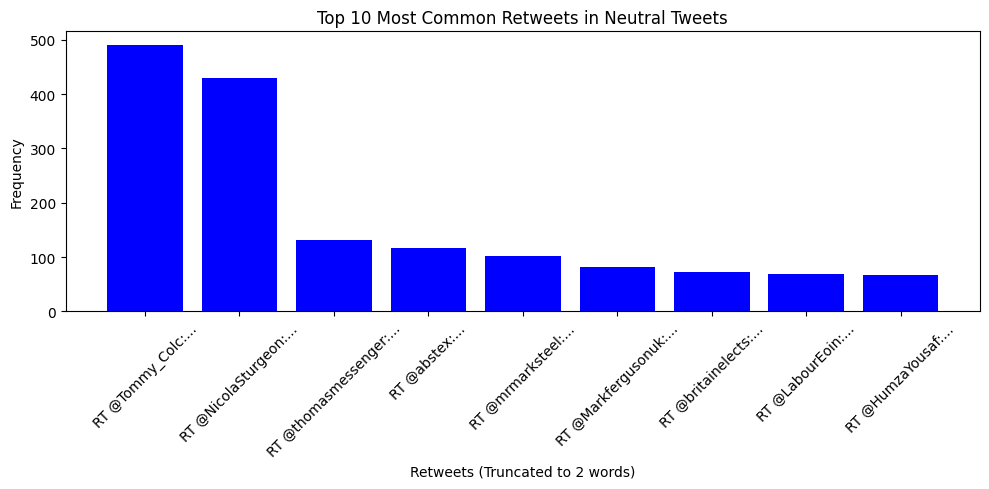

In [ ]:
# Function to truncate retweets to first 2 words
def truncate_retweet(retweet, word_limit=2):
    words = retweet.split()[:word_limit]  # Take the first 4 words
    return ' '.join(words) + "..."  # Join them with "..." at the end

# Calculate and visualize top 10 common retweets for each category
for category, tweets in all_tweets.items():
    retweet_freq = extract_retweets(tweets)  # Function to extract retweets and calculate frequency
    common_retweets = retweet_freq.most_common(10)  # Get the top 10 most common retweets

    # Check if there are any retweets, if not, print a message
    if len(common_retweets) == 0:
        print(f"No retweets found in {category} tweets.\n")
    else:
        # Unpack the retweets and their frequencies for plotting
        retweets, frequencies = zip(*common_retweets)

        # Truncate retweets for visualization
        truncated_retweets = [truncate_retweet(retweet) for retweet in retweets]

        # Create the bar chart for each category
        plt.figure(figsize=(10, 5))
        plt.bar(truncated_retweets, frequencies, color=colors[category])  # Apply the corresponding color

        # Add labels and title
        plt.xlabel('Retweets (Truncated to 2 words)')
        plt.ylabel('Frequency')
        plt.title(f"Top 10 Most Common Retweets in {category} Tweets")



        # Rotate the x-axis labels for better readability
        plt.xticks(rotation=45)

        # Display the chart
        plt.tight_layout()
        plt.show()


#**2. Preprocess the text data by performing the following steps**

In [ ]:
# Load a sample of tweets from the twitter_samples corpus in which i have added positive, negative and neutral tweets
sample_tweets = positive_tweets + negative_tweets + neutral_tweets


## **2.1 Tokenization**

In [ ]:
tweets=sample_tweets

In [ ]:
# List of text-based emoticons (both with and without hyphens)
emoticons = [
    r':-?\)', r';-?\)', r':\{', r':-?\|', r':-?C', r":-?'", r':-?D', r':-?\*', r':-?P', r':-?O', r':-?/', r'=?O'
]

# Combine the emoticon patterns into one
emoticon_pattern = '|'.join(emoticons)

# Function to tokenize while keeping hashtags, mentions, URLs, and specific emoticons intact
def tokenize_with_custom_regex(tweet):
    # Define a pattern to keep hashtags (#), mentions (@), URLs, words, punctuation, and the defined emoticons intact
    pattern = r'@\w+|#\w+|https?://[^\s]+|' + emoticon_pattern + r'|[\w]+|[^\w\s]'
    tokenizer = RegexpTokenizer(pattern)
    tokens = tokenizer.tokenize(tweet)
    return tokens

# Create a list to store tokenized tweets
tokenized_tweets = []

# Apply tokenization and store all tokens for each tweet
for tweet in tweets:
    # Tokenize using custom regex (this will retain special characters like URLs, emoticons, hashtags, and @ mentions)
    custom_tokens = tokenize_with_custom_regex(tweet)

    # Append the tokenized version of the tweet to the tokenized_tweets list
    tokenized_tweets.append({'tokens': custom_tokens})

# Loop to process only the first 5 tweets (in this case we have 5)
print("\nProcessing the first 5 tweets:")

for tweet in tweets[:5]:
    print(f"\nOriginal Tweet: {tweet}")

    # Tokenize using custom regex
    custom_tokens = tokenize_with_custom_regex(tweet)

    # Show all tokens from the list
    print(f"Tokens from Custom Tokenizer: {custom_tokens}")



Processing the first 5 tweets:

Original Tweet: #FollowFriday @France_Inte @PKuchly57 @Milipol_Paris for being top engaged members in my community this week :)
Tokens from Custom Tokenizer: ['#FollowFriday', '@France_Inte', '@PKuchly57', '@Milipol_Paris', 'for', 'being', 'top', 'engaged', 'members', 'in', 'my', 'community', 'this', 'week', ':)']

Original Tweet: @Lamb2ja Hey James! How odd :/ Please call our Contact Centre on 02392441234 and we will be able to assist you :) Many thanks!
Tokens from Custom Tokenizer: ['@Lamb2ja', 'Hey', 'James', '!', 'How', 'odd', ':/', 'Please', 'call', 'our', 'Contact', 'Centre', 'on', '02392441234', 'and', 'we', 'will', 'be', 'able', 'to', 'assist', 'you', ':)', 'Many', 'thanks', '!']

Original Tweet: @DespiteOfficial we had a listen last night :) As You Bleed is an amazing track. When are you in Scotland?!
Tokens from Custom Tokenizer: ['@DespiteOfficial', 'we', 'had', 'a', 'listen', 'last', 'night', ':)', 'As', 'You', 'Bleed', 'is', 'an', 'amazing

In [ ]:
tokenized_tweets[1]

{'tokens': ['@Lamb2ja',
  'Hey',
  'James',
  '!',
  'How',
  'odd',
  ':/',
  'Please',
  'call',
  'our',
  'Contact',
  'Centre',
  'on',
  '02392441234',
  'and',
  'we',
  'will',
  'be',
  'able',
  'to',
  'assist',
  'you',
  ':)',
  'Many',
  'thanks',
  '!']}

##**2.2 Stopword Removal**

In [ ]:
# Load English stopwords
stop_words = set(stopwords.words('english'))

# Create a new list to store cleaned tweets (without stopwords)
stopword_rmv_tweets = []

# Function to remove stopwords from the tokens
def remove_stopwords(tokens):
    # Filter out tokens that are stopwords
    filtered_tokens = [word for word in tokens if word.lower() not in stop_words]
    return filtered_tokens

# Iterate through each tweet in tokenized_tweets
for tweet in tokenized_tweets:
    tokens = tweet['tokens']  # Get the tokens
    # Remove stopwords from tokens
    filtered_tokens = remove_stopwords(tokens)
    # Store the cleaned tweet (without stopwords) in a new list
    stopword_rmv_tweets.append({'tokens': filtered_tokens})

for tweet in tokenized_tweets[:5]:
    print(f"\nOriginal Tweet: {tweet}")

    tokens = tweet['tokens']  # Get the tokens

    filtered_tokens = remove_stopwords(tokens)

    # Show all tokens from the list
    print(f"Stop words removed : {filtered_tokens}")



Original Tweet: {'tokens': ['#FollowFriday', '@France_Inte', '@PKuchly57', '@Milipol_Paris', 'for', 'being', 'top', 'engaged', 'members', 'in', 'my', 'community', 'this', 'week', ':)']}
Stop words removed : ['#FollowFriday', '@France_Inte', '@PKuchly57', '@Milipol_Paris', 'top', 'engaged', 'members', 'community', 'week', ':)']

Original Tweet: {'tokens': ['@Lamb2ja', 'Hey', 'James', '!', 'How', 'odd', ':/', 'Please', 'call', 'our', 'Contact', 'Centre', 'on', '02392441234', 'and', 'we', 'will', 'be', 'able', 'to', 'assist', 'you', ':)', 'Many', 'thanks', '!']}
Stop words removed : ['@Lamb2ja', 'Hey', 'James', '!', 'odd', ':/', 'Please', 'call', 'Contact', 'Centre', '02392441234', 'able', 'assist', ':)', 'Many', 'thanks', '!']

Original Tweet: {'tokens': ['@DespiteOfficial', 'we', 'had', 'a', 'listen', 'last', 'night', ':)', 'As', 'You', 'Bleed', 'is', 'an', 'amazing', 'track', '.', 'When', 'are', 'you', 'in', 'Scotland', '?', '!']}
Stop words removed : ['@DespiteOfficial', 'listen', 'l

In [ ]:
stopword_rmv_tweets[1]

{'tokens': ['@Lamb2ja',
  'Hey',
  'James',
  '!',
  'odd',
  ':/',
  'Please',
  'call',
  'Contact',
  'Centre',
  '02392441234',
  'able',
  'assist',
  ':)',
  'Many',
  'thanks',
  '!']}

## **2.3 Normalization**

In [ ]:
# Create a new list to store the normalized (lowercased) tokens
normalized_tweets = []

# Function to normalize tokens by converting them to lowercase
def normalize_tokens(tokens):
    # Convert each token to lowercase
    normalized_tokens = [word.lower() for word in tokens]
    return normalized_tokens

# Iterate through each tweet in stopword_rmv_tweets
for tweet in stopword_rmv_tweets:
    tokens = tweet['tokens']  # Get the tokens
    # Normalize tokens (convert to lowercase)
    normalized_tokens = normalize_tokens(tokens)
    # Store the normalized tweet (lowercased tokens) in a new list
    normalized_tweets.append({'tokens': normalized_tokens})

for tweet in stopword_rmv_tweets[:5]:
    print(f"\nOriginal Tweet: {tweet}")

    tokens = tweet['tokens']  # Get the tokens

    normalized_tokens = normalize_tokens(tokens)

    # Show all tokens from the list
    print(f"normalized words : {normalized_tokens}")



Original Tweet: {'tokens': ['#FollowFriday', '@France_Inte', '@PKuchly57', '@Milipol_Paris', 'top', 'engaged', 'members', 'community', 'week', ':)']}
normalized words : ['#followfriday', '@france_inte', '@pkuchly57', '@milipol_paris', 'top', 'engaged', 'members', 'community', 'week', ':)']

Original Tweet: {'tokens': ['@Lamb2ja', 'Hey', 'James', '!', 'odd', ':/', 'Please', 'call', 'Contact', 'Centre', '02392441234', 'able', 'assist', ':)', 'Many', 'thanks', '!']}
normalized words : ['@lamb2ja', 'hey', 'james', '!', 'odd', ':/', 'please', 'call', 'contact', 'centre', '02392441234', 'able', 'assist', ':)', 'many', 'thanks', '!']

Original Tweet: {'tokens': ['@DespiteOfficial', 'listen', 'last', 'night', ':)', 'Bleed', 'amazing', 'track', '.', 'Scotland', '?', '!']}
normalized words : ['@despiteofficial', 'listen', 'last', 'night', ':)', 'bleed', 'amazing', 'track', '.', 'scotland', '?', '!']

Original Tweet: {'tokens': ['@97sides', 'CONGRATS', ':)']}
normalized words : ['@97sides', 'con

In [ ]:
normalized_tweets[1]

{'tokens': ['@lamb2ja',
  'hey',
  'james',
  '!',
  'odd',
  ':/',
  'please',
  'call',
  'contact',
  'centre',
  '02392441234',
  'able',
  'assist',
  ':)',
  'many',
  'thanks',
  '!']}

## **2.4 Extraction of words with Hashtag(\#) and Mention(@)**

In [ ]:
# Function to extract hashtags, mentions, and return the original text using RegEx
def extract_hashtags_mentions(tokens):
    hashtags = []
    mentions = []

    # Join tokens into a single string for RegEx processing
    text = ' '.join(tokens)

    # Find all hashtags and mentions using RegEx
    hashtags = re.findall(r'#\w+', text)  # Extract hashtags
    mentions = re.findall(r'@\w+', text)  # Extract mentions

    # The original text remains unchanged, including hashtags and mentions
    original_text = text

    # Store the results in a dictionary
    result = {
        'hashtags': hashtags,
        'mentions': mentions,
        'text': original_text  # Store the original text with hashtags and mentions included
    }

    return result

# Create a list to store results
rmv_hashtag_mention_data = []

# Process each tweet in normalized_tweets
for tweet in normalized_tweets:
    tokens = tweet['tokens']  # Extract the tokens
    result = extract_hashtags_mentions(tokens)  # Apply the extraction function
    rmv_hashtag_mention_data.append(result)  # Store the result

# Output the extracted data
for data in rmv_hashtag_mention_data[:5]:
    print(f"Hashtags: {data['hashtags']}")
    print(f"Mentions: {data['mentions']}")
    print(f"Original Text : {data['text']}\n")


Hashtags: ['#followfriday']
Mentions: ['@france_inte', '@pkuchly57', '@milipol_paris']
Original Text : #followfriday @france_inte @pkuchly57 @milipol_paris top engaged members community week :)

Hashtags: []
Mentions: ['@lamb2ja']
Original Text : @lamb2ja hey james ! odd :/ please call contact centre 02392441234 able assist :) many thanks !

Hashtags: []
Mentions: ['@despiteofficial']
Original Text : @despiteofficial listen last night :) bleed amazing track . scotland ? !

Hashtags: []
Mentions: ['@97sides']
Original Text : @97sides congrats :)

Hashtags: []
Mentions: []
Original Text : yeaaaah yippppy ! ! ! accnt verified rqst succeed got blue tick mark fb profile :) 15 days



In [ ]:
rmv_hashtag_mention_data[1]

{'hashtags': [],
 'mentions': ['@lamb2ja'],
 'text': '@lamb2ja hey james ! odd :/ please call contact centre 02392441234 able assist :) many thanks !'}

## **2.5 Extraction of URLS, and replace with URLS**

In [ ]:
# Function to extract URLs and replace them with the token 'url'
def extract_and_replace_urls_in_text(text):
    # RegEx pattern to identify URLs (http/https)
    url_pattern = r'https?://[^\s]+'

    # Find all URLs using RegEx
    urls = re.findall(url_pattern, text)

    # Replace all URLs with the token 'url'
    text_with_replacement = re.sub(url_pattern, 'url', text)

    # Store the results in a dictionary
    result = {
        'urls': urls,
        'text': text_with_replacement  # Original text with URLs replaced
    }

    return result

# Create a list to store results
url_replaced_data = []

# Process each tweet in rmv_hashtag_mention_data
for tweet in rmv_hashtag_mention_data:
    text = tweet['text']  # Extract the original text

    # Apply the URL extraction and replacement function
    result = extract_and_replace_urls_in_text(text)

    # Create a new dictionary with the original hashtags, mentions, and the modified text
    modified_tweet = {
        'hashtags': tweet['hashtags'],
        'mentions': tweet['mentions'],
        'text': result['text'],  # The modified text with URLs replaced
        'urls': result['urls']    # Extracted URLs
    }

    # Append the modified tweet to the new list
    url_replaced_data.append(modified_tweet)

# Output the extracted data
for data in url_replaced_data[:6]:
    print(f"Hashtags: {data['hashtags']}")
    print(f"Mentions: {data['mentions']}")
    print(f"Extracted URLs: {data['urls']}")
    print(f"Text with URLs replaced: {data['text']}\n")

Hashtags: ['#followfriday']
Mentions: ['@france_inte', '@pkuchly57', '@milipol_paris']
Extracted URLs: []
Text with URLs replaced: #followfriday @france_inte @pkuchly57 @milipol_paris top engaged members community week :)

Hashtags: []
Mentions: ['@lamb2ja']
Extracted URLs: []
Text with URLs replaced: @lamb2ja hey james ! odd :/ please call contact centre 02392441234 able assist :) many thanks !

Hashtags: []
Mentions: ['@despiteofficial']
Extracted URLs: []
Text with URLs replaced: @despiteofficial listen last night :) bleed amazing track . scotland ? !

Hashtags: []
Mentions: ['@97sides']
Extracted URLs: []
Text with URLs replaced: @97sides congrats :)

Hashtags: []
Mentions: []
Extracted URLs: []
Text with URLs replaced: yeaaaah yippppy ! ! ! accnt verified rqst succeed got blue tick mark fb profile :) 15 days

Hashtags: ['#flipkartfashionfriday']
Mentions: ['@bhaktisbanter', '@pallaviruhail']
Extracted URLs: ['http://t.co/ebz0l2venm']
Text with URLs replaced: @bhaktisbanter @pallav

## **2.6 Removing emoticons/emojis**

In [ ]:

# Emoticons and emojis list for removal (you can expand this with more patterns)
emoticons_pattern = r'[:;=8]-?[)\](DPpOo]|:-?[/\\|]'

# Function to remove emoticons/emoji from the text
def remove_emoticons(text):
    # Use RegEx to find and remove emoticons
    cleaned_text = re.sub(emoticons_pattern, '', text)
    return cleaned_text

# Create a list to store cleaned data
rmv_emojis_data = []

# Process each tweet in url_replaced_data
for tweet in url_replaced_data:
    text = tweet['text']  # Extract the text

    # Remove emoticons from the text
    cleaned_text = remove_emoticons(text)

    # Create a new dictionary with cleaned text, keeping hashtags, mentions, and urls intact
    cleaned_tweet = {
        'hashtags': tweet['hashtags'],
        'mentions': tweet['mentions'],
        'urls': tweet['urls'],
        'text': cleaned_text  # The cleaned text without emoticons
    }

    # Append the cleaned tweet to the new list
    rmv_emojis_data.append(cleaned_tweet)

# Output the cleaned data
for data in rmv_emojis_data[:5]:
    print(f"Hashtags: {data['hashtags']}")
    print(f"Mentions: {data['mentions']}")
    print(f"Extracted URLs: {data['urls']}")
    print(f"Cleaned Text (without emoticons): {data['text']}\n")


Hashtags: ['#followfriday']
Mentions: ['@france_inte', '@pkuchly57', '@milipol_paris']
Extracted URLs: []
Cleaned Text (without emoticons): #followfriday @france_inte @pkuchly57 @milipol_paris top engaged members community week 

Hashtags: []
Mentions: ['@lamb2ja']
Extracted URLs: []
Cleaned Text (without emoticons): @lamb2ja hey james ! odd  please call contact centre 02392441234 able assist  many thanks !

Hashtags: []
Mentions: ['@despiteofficial']
Extracted URLs: []
Cleaned Text (without emoticons): @despiteofficial listen last night  bleed amazing track . scotland ? !

Hashtags: []
Mentions: ['@97sides']
Extracted URLs: []
Cleaned Text (without emoticons): @97sides congrats 

Hashtags: []
Mentions: []
Extracted URLs: []
Cleaned Text (without emoticons): yeaaaah yippppy ! ! ! accnt verified rqst succeed got blue tick mark fb profile  15 days



# **3. BAG of words representation on processed text data**

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
import pandas as pd
import string


## **3.1 BOW to identify positive, negative, and neutral tweets using CountVectorizer**

In [ ]:

# Load English stopwords and add punctuation
stop_words = set(stopwords.words('english'))
stop_words.update(string.punctuation)

# Initialize lemmatizer
lemmatizer = WordNetLemmatizer()

# Function to remove URLs, mentions, and hashtags from the tweets
def clean_tweet(tweet):
    tweet = re.sub(r"http\S+|www\S+|https\S+", '', tweet, flags=re.MULTILINE)  # Remove URLs
    tweet = re.sub(r"@\w+", '', tweet)  # Remove @mentions
    tweet = re.sub(r"#\w+", '', tweet)  # Remove hashtags
    return tweet

# Function to preprocess tweets: tokenize, remove stopwords, lemmatize, and return cleaned text
def preprocess_tweet(tweet):
    tweet = clean_tweet(tweet)  # Remove URLs, mentions, and hashtags
    words = word_tokenize(tweet.lower())  # Tokenize and convert to lowercase
    filtered_words = [
        lemmatizer.lemmatize(word) for word in words if word.isalpha() and word not in stop_words
    ]  # Remove stopwords, punctuation, and apply lemmatization
    return ' '.join(filtered_words)  # Return the cleaned tweet as a string

# Preprocess each category of tweets
cleaned_positive_tweets = [preprocess_tweet(tweet) for tweet in positive_tweets]
cleaned_negative_tweets = [preprocess_tweet(tweet) for tweet in negative_tweets]
cleaned_neutral_tweets = [preprocess_tweet(tweet) for tweet in neutral_tweets]

# Combine the cleaned tweets for Bag-of-Words representation
all_cleaned_tweets = cleaned_positive_tweets + cleaned_negative_tweets + cleaned_neutral_tweets
labels = ['Positive'] * len(cleaned_positive_tweets) + ['Negative'] * len(cleaned_negative_tweets) + ['Neutral'] * len(cleaned_neutral_tweets)

# Initialize CountVectorizer for Bag-of-Words model
vectorizer = CountVectorizer()

# Fit and transform the preprocessed text data
bow_matrix = vectorizer.fit_transform(all_cleaned_tweets)

# Convert the BoW matrix into a DataFrame for better visualization
bow_df = pd.DataFrame(bow_matrix.toarray(), columns=vectorizer.get_feature_names_out(), index=labels)

# Output the DataFrame
print("Bag-of-Words Representation (BoW) for Cleaned Tweets:")
print(bow_df)

Bag-of-Words Representation (BoW) for Cleaned Tweets:
          aa  aaa  aaaaaaaaaaa  aaaaaaaaaaaaa  aaaaaaaaaaaah  aaaaaand  \
Positive   0    0            0              0              0         0   
Positive   0    0            0              0              0         0   
Positive   0    0            0              0              0         0   
Positive   0    0            0              0              0         0   
Positive   0    0            0              0              0         0   
...       ..  ...          ...            ...            ...       ...   
Neutral    0    0            0              0              0         0   
Neutral    0    0            0              0              0         0   
Neutral    0    0            0              0              0         0   
Neutral    0    0            0              0              0         0   
Neutral    0    0            0              0              0         0   

          aaaaages  aaaaahhhhhhhh  aaaaand  aaaah  ...  ф

In [ ]:
# Get the most frequent words in each category (Positive, Negative, Neutral)
positive_bow = bow_df.loc['Positive'].sum().sort_values(ascending=False).head(10)
negative_bow = bow_df.loc['Negative'].sum().sort_values(ascending=False).head(10)
neutral_bow = bow_df.loc['Neutral'].sum().sort_values(ascending=False).head(10)

print("\nTop 10 Most Frequent Words in Positive Tweets:")
print(positive_bow)

print("\nTop 10 Most Frequent Words in Negative Tweets:")
print(negative_bow)

print("\nTop 10 Most Frequent Words in Neutral Tweets:")
print(neutral_bow)


Top 10 Most Frequent Words in Positive Tweets:
thanks    393
love      323
follow    303
thank     246
day       242
good      234
like      223
happy     191
amp       174
get       174
dtype: int64

Top 10 Most Frequent Words in Negative Tweets:
please    274
miss      243
want      226
like      211
get       189
ca        180
na        176
time      162
day       150
one       150
dtype: int64

Top 10 Most Frequent Words in Neutral Tweets:
rt          13538
tory         5769
miliband     5560
snp          4605
ed           2842
labour       2733
cameron      2635
farage       1899
ukip         1827
david        1698
dtype: int64


## **3.2 Graphical representation of top 10 in each category**

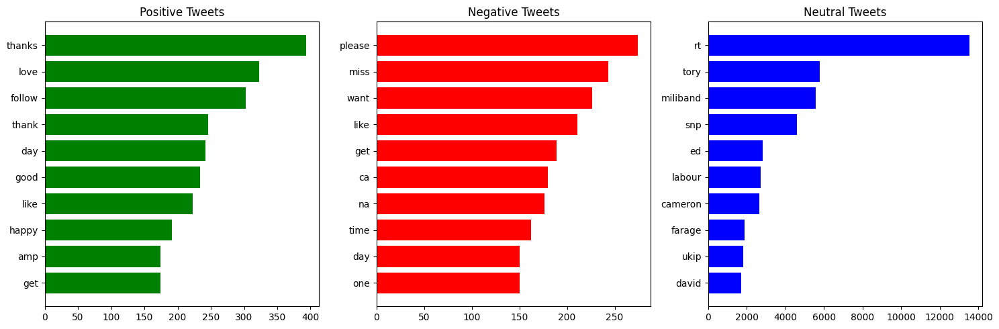

In [ ]:
# Create subplots for each category
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Plot for Positive Tweets
axs[0].barh(positive_bow.index, positive_bow.values, color='green')
axs[0].set_title("Positive Tweets")
axs[0].invert_yaxis()  # Invert the y-axis to show the largest value on top

# Plot for Negative Tweets
axs[1].barh(negative_bow.index, negative_bow.values, color='red')
axs[1].set_title("Negative Tweets")
axs[1].invert_yaxis()

# Plot for Neutral Tweets
axs[2].barh(neutral_bow.index, neutral_bow.values, color='blue')
axs[2].set_title("Neutral Tweets")
axs[2].invert_yaxis()

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


#**4. Perform part of speech tagging on the preprocessed text data**

## **4.1 Common POS tags in the positive,negative and neutral tweets**

In [ ]:
from nltk import pos_tag

In [ ]:
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [ ]:
# Load English stopwords and add punctuation
stop_words = set(stopwords.words('english'))
stop_words.update(string.punctuation)

# Initialize lemmatizer
lemmatizer = WordNetLemmatizer()

# Function to remove URLs, mentions, and hashtags from the tweets
def clean_tweet(tweet):
    tweet = re.sub(r"http\S+|www\S+|https\S+", '', tweet, flags=re.MULTILINE)  # Remove URLs
    tweet = re.sub(r"@\w+", '', tweet)  # Remove @mentions
    tweet = re.sub(r"#\w+", '', tweet)  # Remove hashtags
    return tweet

# Function to preprocess tweets: tokenize, remove stopwords, lemmatize, and apply POS tagging
def preprocess_and_pos_tag(tweets):
    pos_tags = []

    for tweet in tweets:
        tweet = clean_tweet(tweet)  # Clean the tweet
        words = word_tokenize(tweet.lower())  # Tokenize and convert to lowercase
        filtered_words = [
            lemmatizer.lemmatize(word) for word in words if word.isalpha() and word not in stop_words
        ]  # Remove stopwords, punctuation, and apply lemmatization
        # Apply POS tagging
        pos_tags.extend([tag for word, tag in pos_tag(filtered_words)])

    return pos_tags

# Apply preprocessing and POS tagging to each category of tweets
positive_pos_tags = preprocess_and_pos_tag(positive_tweets)
negative_pos_tags = preprocess_and_pos_tag(negative_tweets)
neutral_pos_tags = preprocess_and_pos_tag(neutral_tweets)

# Get the most common POS tags in each category
positive_pos_counts = Counter(positive_pos_tags).most_common(10)
negative_pos_counts = Counter(negative_pos_tags).most_common(10)
neutral_pos_counts = Counter(neutral_pos_tags).most_common(10)

# Convert to dictionaries for plotting
positive_pos_dict = dict(positive_pos_counts)
negative_pos_dict = dict(negative_pos_counts)
neutral_pos_dict = dict(neutral_pos_counts)

## **4.2 Graphical representation of top 10 in each category**

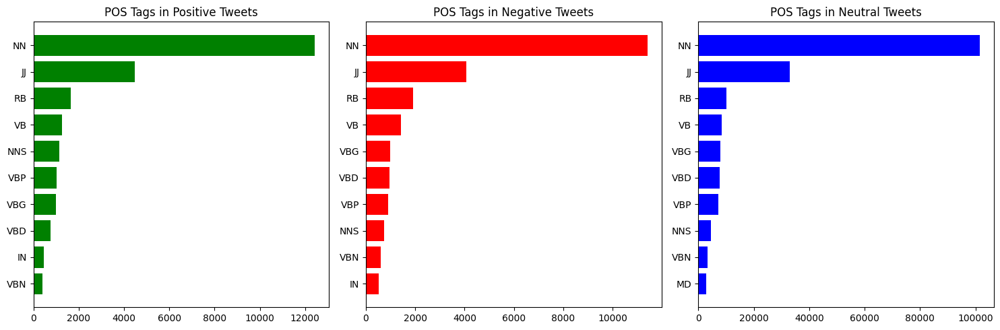

In [ ]:
# Plotting the results
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Plot for Positive Tweets
axs[0].barh(list(positive_pos_dict.keys()), list(positive_pos_dict.values()), color='green')
axs[0].set_title("POS Tags in Positive Tweets")
axs[0].invert_yaxis()

# Plot for Negative Tweets
axs[1].barh(list(negative_pos_dict.keys()), list(negative_pos_dict.values()), color='red')
axs[1].set_title("POS Tags in Negative Tweets")
axs[1].invert_yaxis()

# Plot for Neutral Tweets
axs[2].barh(list(neutral_pos_dict.keys()), list(neutral_pos_dict.values()), color='blue')
axs[2].set_title("POS Tags in Neutral Tweets")
axs[2].invert_yaxis()

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

# **5. N-grams to identify common phrases in positive, negative, and neutral tweets**

- initial preprocessing for this section:

In [ ]:
# Load English stopwords and add punctuation
stop_words = set(stopwords.words('english'))
stop_words.update(string.punctuation)

# Function to remove URLs, mentions, and hashtags from the tweets
def clean_tweet(tweet):
    tweet = re.sub(r"http\S+|www\S+|https\S+", '', tweet, flags=re.MULTILINE)  # Remove URLs
    tweet = re.sub(r"@\w+", '', tweet)  # Remove @mentions
    tweet = re.sub(r"#\w+", '', tweet)  # Remove hashtags
    return tweet

# Function to preprocess tweets: tokenize and remove stopwords without lemmatization
def preprocess_without_lemmatization(tweets):
    processed_tweets = []

    for tweet in tweets:
        tweet = clean_tweet(tweet)  # Clean the tweet
        words = word_tokenize(tweet.lower())  # Tokenize and convert to lowercase
        filtered_words = [
            word for word in words if word.isalpha() and word not in stop_words
        ]  # Remove stopwords, punctuation, and keep only alphabetic words
        processed_tweets.append(filtered_words)  # Append the filtered words to the list

    return processed_tweets

# Preprocess each category of tweets without lemmatization
preprocessed_positive = preprocess_without_lemmatization(positive_tweets)
preprocessed_negative = preprocess_without_lemmatization(negative_tweets)
preprocessed_neutral = preprocess_without_lemmatization(neutral_tweets)

# Output the preprocessed tweets without lemmatization
print("Preprocessed Positive Tweets (Without Lemmatization):", preprocessed_positive)
print("Preprocessed Negative Tweets (Without Lemmatization):", preprocessed_negative)
print("Preprocessed Neutral Tweets (Without Lemmatization):", preprocessed_neutral)


Preprocessed Positive Tweets (Without Lemmatization): [['top', 'engaged', 'members', 'community', 'week'], ['hey', 'james', 'odd', 'please', 'call', 'contact', 'centre', 'able', 'assist', 'many', 'thanks'], ['listen', 'last', 'night', 'bleed', 'amazing', 'track', 'scotland'], ['congrats'], ['yeaaaah', 'yippppy', 'accnt', 'verified', 'rqst', 'succeed', 'got', 'blue', 'tick', 'mark', 'fb', 'profile', 'days'], ['one', 'irresistible'], ['like', 'keep', 'lovely', 'customers', 'waiting', 'long', 'hope', 'enjoy', 'happy', 'friday', 'lwwf'], ['second', 'thought', 'enough', 'time', 'dd', 'new', 'shorts', 'entering', 'system', 'sheep', 'must', 'buying'], ['jgh', 'go', 'bayan', 'bye'], ['act', 'mischievousness', 'calling', 'etl', 'layer', 'warehousing', 'app', 'katamari', 'name', 'implies', 'p'], ['top', 'influencers', 'community', 'week'], ['would', 'love', 'big', 'juicy', 'selfies'], ['follow', 'amp', 'follow', 'u', 'back'], ['perfect', 'already', 'know', 'waiting'], ['great', 'new', 'opportuni

## **5.1 Lemmatization to reduce words to their base form at preprocessesd text**

In [ ]:
# Initialize lemmatizer
lemmatizer = WordNetLemmatizer()

# Function to apply lemmatization
def apply_lemmatization(preprocessed_tweets):
    lemmatized_tweets = []

    for tweet in preprocessed_tweets:
        lemmatized_words = [lemmatizer.lemmatize(word) for word in tweet]  # Apply lemmatization
        lemmatized_tweets.append(lemmatized_words)  # Append lemmatized words to the list

    return lemmatized_tweets

# Apply lemmatization to the preprocessed tweets
lemmatized_positive = apply_lemmatization(preprocessed_positive)
lemmatized_negative = apply_lemmatization(preprocessed_negative)
lemmatized_neutral = apply_lemmatization(preprocessed_neutral)

# Output the lemmatized tweets
print("Lemmatized Positive Tweets:", lemmatized_positive)
print("Lemmatized Negative Tweets:", lemmatized_negative)
print("Lemmatized Neutral Tweets:", lemmatized_neutral)


Lemmatized Positive Tweets: [['top', 'engaged', 'member', 'community', 'week'], ['hey', 'james', 'odd', 'please', 'call', 'contact', 'centre', 'able', 'assist', 'many', 'thanks'], ['listen', 'last', 'night', 'bleed', 'amazing', 'track', 'scotland'], ['congrats'], ['yeaaaah', 'yippppy', 'accnt', 'verified', 'rqst', 'succeed', 'got', 'blue', 'tick', 'mark', 'fb', 'profile', 'day'], ['one', 'irresistible'], ['like', 'keep', 'lovely', 'customer', 'waiting', 'long', 'hope', 'enjoy', 'happy', 'friday', 'lwwf'], ['second', 'thought', 'enough', 'time', 'dd', 'new', 'short', 'entering', 'system', 'sheep', 'must', 'buying'], ['jgh', 'go', 'bayan', 'bye'], ['act', 'mischievousness', 'calling', 'etl', 'layer', 'warehousing', 'app', 'katamari', 'name', 'implies', 'p'], ['top', 'influencers', 'community', 'week'], ['would', 'love', 'big', 'juicy', 'selfies'], ['follow', 'amp', 'follow', 'u', 'back'], ['perfect', 'already', 'know', 'waiting'], ['great', 'new', 'opportunity', 'junior', 'triathletes', 

## **5.2 N-grams from preprocessed text data**

In [ ]:
from nltk.util import ngrams
from collections import Counter
from nltk.util import ngrams


In [ ]:

# Function to generate n-grams (unigrams, bigrams, trigrams)
def generate_ngrams(lemmatized_tweets, n=1):
    ngram_tweets = []

    for tweet in lemmatized_tweets:
        n_grams = list(ngrams(tweet, n))  # Generate n-grams
        ngram_tweets.append(n_grams)  # Append n-grams to the list

    return ngram_tweets

# Generating unigrams, bigrams, and trigrams for positive, negative, and neutral tweets
# Unigrams are simply the lemmatized words, so no need to generate them separately.

# unigram (n=1)
unigrams_positive = lemmatized_positive
unigrams_negative = lemmatized_negative
unigrams_neutral = lemmatized_neutral


# Bigrams (n=2)
positive_bigrams = generate_ngrams(lemmatized_positive, n=2)
negative_bigrams = generate_ngrams(lemmatized_negative, n=2)
neutral_bigrams = generate_ngrams(lemmatized_neutral, n=2)

# Trigrams (n=3)
positive_trigrams = generate_ngrams(lemmatized_positive, n=3)
negative_trigrams = generate_ngrams(lemmatized_negative, n=3)
neutral_trigrams = generate_ngrams(lemmatized_neutral, n=3)

# Output the results

# Output the results (Unigrams, Bigrams, Trigrams)
print("Unigrams (Positive):", unigrams_positive)
print("Unigrams (Negative):", unigrams_negative)
print("Unigrams (Neutral):", unigrams_neutral)

print("\n")

print("Positive Bigrams:", positive_bigrams)
print("Negative Bigrams:", negative_bigrams)
print("Neutral Bigrams:", neutral_bigrams)

print("\n")

print("Positive Trigrams:", positive_trigrams)
print("Negative Trigrams:", negative_trigrams)
print("Neutral Trigrams:", neutral_trigrams)


Unigrams (Positive): [['top', 'engaged', 'member', 'community', 'week'], ['hey', 'james', 'odd', 'please', 'call', 'contact', 'centre', 'able', 'assist', 'many', 'thanks'], ['listen', 'last', 'night', 'bleed', 'amazing', 'track', 'scotland'], ['congrats'], ['yeaaaah', 'yippppy', 'accnt', 'verified', 'rqst', 'succeed', 'got', 'blue', 'tick', 'mark', 'fb', 'profile', 'day'], ['one', 'irresistible'], ['like', 'keep', 'lovely', 'customer', 'waiting', 'long', 'hope', 'enjoy', 'happy', 'friday', 'lwwf'], ['second', 'thought', 'enough', 'time', 'dd', 'new', 'short', 'entering', 'system', 'sheep', 'must', 'buying'], ['jgh', 'go', 'bayan', 'bye'], ['act', 'mischievousness', 'calling', 'etl', 'layer', 'warehousing', 'app', 'katamari', 'name', 'implies', 'p'], ['top', 'influencers', 'community', 'week'], ['would', 'love', 'big', 'juicy', 'selfies'], ['follow', 'amp', 'follow', 'u', 'back'], ['perfect', 'already', 'know', 'waiting'], ['great', 'new', 'opportunity', 'junior', 'triathletes', 'aged',

## **5.3 Frequency of each N-gram**

In [ ]:
# Function to generate n-grams (unigrams, bigrams, trigrams) and calculate their frequency
def calculate_ngram_frequencies(lemmatized_tweets, n=1):
    ngram_freq = Counter()  # Initialize a counter to store frequencies

    for tweet in lemmatized_tweets:
        n_grams = list(ngrams(tweet, n))  # Generate n-grams
        ngram_freq.update(n_grams)  # Update the counter with the n-grams

    return ngram_freq

# Unigrams frequencies for each category (WITHOUT sorting)
positive_unigram_freq = calculate_ngram_frequencies(lemmatized_positive, n=1)
negative_unigram_freq = calculate_ngram_frequencies(lemmatized_negative, n=1)
neutral_unigram_freq = calculate_ngram_frequencies(lemmatized_neutral, n=1)


# Calculate bigram frequencies for each category (WITHOUT sorting)
positive_bigram_freq = calculate_ngram_frequencies(lemmatized_positive, n=2)
negative_bigram_freq = calculate_ngram_frequencies(lemmatized_negative, n=2)
neutral_bigram_freq = calculate_ngram_frequencies(lemmatized_neutral, n=2)

# Calculate trigram frequencies for each category (WITHOUT sorting)
positive_trigram_freq = calculate_ngram_frequencies(lemmatized_positive, n=3)
negative_trigram_freq = calculate_ngram_frequencies(lemmatized_negative, n=3)
neutral_trigram_freq = calculate_ngram_frequencies(lemmatized_neutral, n=3)

# Output the bigrams and trigrams with their frequencies WITHOUT sorting

# Unigrams
print("Unigrams in Positive Tweets with Frequency:", list(positive_unigram_freq.items())[:5])
print("Unigrams in Negative Tweets with Frequency:", list(negative_unigram_freq.items())[:5])
print("Unigrams in Neutral Tweets with Frequency:", list(neutral_unigram_freq.items())[:5])

print("\n")

print("Bigrams in Positive Tweets with Frequency:", list(positive_bigram_freq.items())[:5])
print("Bigrams in Negative Tweets with Frequency:", list(negative_bigram_freq.items())[:5])
print("Bigrams in Neutral Tweets with Frequency:", list(neutral_bigram_freq.items())[:5])

print("\n")

print("Trigrams in Positive Tweets with Frequency:", list(positive_trigram_freq.items())[:5])
print("Trigrams in Negative Tweets with Frequency:", list(negative_trigram_freq.items())[:5])
print("Trigrams in Neutral Tweets with Frequency:", list(neutral_trigram_freq.items())[:5])


Unigrams in Positive Tweets with Frequency: [(('top',), 30), (('engaged',), 7), (('member',), 16), (('community',), 31), (('week',), 83)]
Unigrams in Negative Tweets with Frequency: [(('hopeless',), 2), (('tmr',), 3), (('everything',), 18), (('kid',), 17), (('section',), 3)]
Unigrams in Neutral Tweets with Frequency: [(('rt',), 13538), (('indirect',), 1), (('cost',), 54), (('uk',), 522), (('eu',), 329)]


Bigrams in Positive Tweets with Frequency: [(('top', 'engaged'), 6), (('engaged', 'member'), 6), (('member', 'community'), 6), (('community', 'week'), 24), (('hey', 'james'), 3)]
Bigrams in Negative Tweets with Frequency: [(('hopeless', 'tmr'), 1), (('everything', 'kid'), 1), (('kid', 'section'), 1), (('section', 'ikea'), 1), (('ikea', 'cute'), 1)]
Bigrams in Neutral Tweets with Frequency: [(('rt', 'indirect'), 1), (('indirect', 'cost'), 1), (('cost', 'uk'), 1), (('uk', 'eu'), 3), (('eu', 'estimated'), 1)]


Trigrams in Positive Tweets with Frequency: [(('top', 'engaged', 'member'), 6

## **5.4 N-grams sorted in descending order**

In [ ]:
# Sorting Unigrams, Bigrams, and Trigrams by frequency using the most_common() method

# For Unigrams
sorted_positive_unigrams = positive_unigram_freq.most_common()
sorted_negative_unigrams = negative_unigram_freq.most_common()
sorted_neutral_unigrams = neutral_unigram_freq.most_common()

# For Bigrams
sorted_positive_bigrams = positive_bigram_freq.most_common()
sorted_negative_bigrams = negative_bigram_freq.most_common()
sorted_neutral_bigrams = neutral_bigram_freq.most_common()

# For Trigrams
sorted_positive_trigrams = positive_trigram_freq.most_common()
sorted_negative_trigrams = negative_trigram_freq.most_common()
sorted_neutral_trigrams = neutral_trigram_freq.most_common()

# Output the sorted n-grams (Unigrams, Bigrams, and Trigrams)

# Unigrams
print("Sorted Unigrams in Positive Tweets:", sorted_positive_unigrams)
print("Sorted Unigrams in Negative Tweets:", sorted_negative_unigrams)
print("Sorted Unigrams in Neutral Tweets:", sorted_neutral_unigrams)

# Bigrams
print("\nSorted Bigrams in Positive Tweets:", sorted_positive_bigrams)
print("Sorted Bigrams in Negative Tweets:", sorted_negative_bigrams)
print("Sorted Bigrams in Neutral Tweets:", sorted_neutral_bigrams)

# Trigrams
print("\nSorted Trigrams in Positive Tweets:", sorted_positive_trigrams)
print("Sorted Trigrams in Negative Tweets:", sorted_negative_trigrams)
print("Sorted Trigrams in Neutral Tweets:", sorted_neutral_trigrams)


Sorted Unigrams in Positive Tweets: [(('thanks',), 393), (('u',), 361), (('love',), 323), (('follow',), 303), (('thank',), 246), (('day',), 242), (('good',), 234), (('like',), 223), (('happy',), 191), (('amp',), 174), (('get',), 174), (('great',), 172), (('hi',), 172), (('see',), 168), (('back',), 162), (('know',), 152), (('lt',), 148), (('new',), 146), (('p',), 143), (('one',), 131), (('hope',), 123), (('time',), 121), (('today',), 115), (('let',), 107), (('friday',), 104), (('nice',), 99), (('morning',), 98), (('please',), 96), (('would',), 90), (('go',), 88), (('much',), 88), (('lot',), 87), (('make',), 87), (('want',), 85), (('via',), 84), (('week',), 83), (('look',), 81), (('well',), 80), (('yes',), 80), (('follower',), 78), (('gt',), 78), (('really',), 78), (('hey',), 77), (('work',), 76), (('weekend',), 73), (('birthday',), 73), (('got',), 72), (('x',), 72), (('night',), 70), (('thing',), 69), (('need',), 68), (('going',), 68), (('welcome',), 68), (('always',), 67), (('best',), 

## **5.5 Top 10 most frequent N-grams for each type of n-gram**

In [ ]:
# Select the top 10 most frequent unigrams for each category
top_10_positive_unigrams = sorted_positive_unigrams[:10]
top_10_negative_unigrams = sorted_negative_unigrams[:10]
top_10_neutral_unigrams = sorted_neutral_unigrams[:10]

# Select the top 10 most frequent bigrams for each category
top_10_positive_bigrams = sorted_positive_bigrams[:10]
top_10_negative_bigrams = sorted_negative_bigrams[:10]
top_10_neutral_bigrams = sorted_neutral_bigrams[:10]

# Select the top 10 most frequent trigrams for each category
top_10_positive_trigrams = sorted_positive_trigrams[:10]
top_10_negative_trigrams = sorted_negative_trigrams[:10]
top_10_neutral_trigrams = sorted_neutral_trigrams[:10]

# Output the top 10 n-grams for unigrams
print("Top 10 Unigrams in Positive Tweets:", top_10_positive_unigrams)
print("Top 10 Unigrams in Negative Tweets:", top_10_negative_unigrams)
print("Top 10 Unigrams in Neutral Tweets:", top_10_neutral_unigrams)

# Output the top 10 n-grams for bigrams
print("\nTop 10 Bigrams in Positive Tweets:", top_10_positive_bigrams)
print("Top 10 Bigrams in Negative Tweets:", top_10_negative_bigrams)
print("Top 10 Bigrams in Neutral Tweets:", top_10_neutral_bigrams)

# Output the top 10 n-grams for trigrams
print("\nTop 10 Trigrams in Positive Tweets:", top_10_positive_trigrams)
print("Top 10 Trigrams in Negative Tweets:", top_10_negative_trigrams)
print("Top 10 Trigrams in Neutral Tweets:", top_10_neutral_trigrams)


Top 10 Unigrams in Positive Tweets: [(('thanks',), 393), (('u',), 361), (('love',), 323), (('follow',), 303), (('thank',), 246), (('day',), 242), (('good',), 234), (('like',), 223), (('happy',), 191), (('amp',), 174)]
Top 10 Unigrams in Negative Tweets: [(('please',), 274), (('miss',), 243), (('u',), 232), (('want',), 226), (('like',), 211), (('get',), 189), (('ca',), 180), (('na',), 176), (('time',), 162), (('day',), 150)]
Top 10 Unigrams in Neutral Tweets: [(('rt',), 13538), (('tory',), 5769), (('miliband',), 5560), (('snp',), 4605), (('ed',), 2842), (('labour',), 2733), (('cameron',), 2635), (('farage',), 1899), (('ukip',), 1827), (('david',), 1698)]

Top 10 Bigrams in Positive Tweets: [(('new', 'follower'), 65), (('follow', 'amp'), 63), (('amp', 'follow'), 63), (('follow', 'u'), 63), (('u', 'back'), 62), (('arrived', 'new'), 60), (('follower', 'unfollowers'), 60), (('unfollowers', 'via'), 60), (('happy', 'birthday'), 52), (('happy', 'friday'), 50)]
Top 10 Bigrams in Negative Tweets

## **5.6 Graphical of top 10 N grams in each category**

Top 10 Unigrams in Positive Tweets


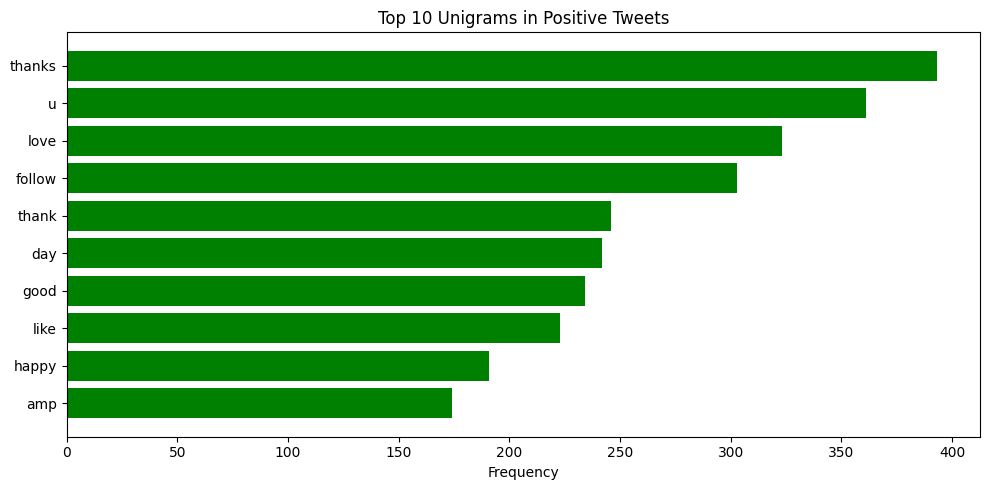

Top 10 Unigrams in Negative Tweets


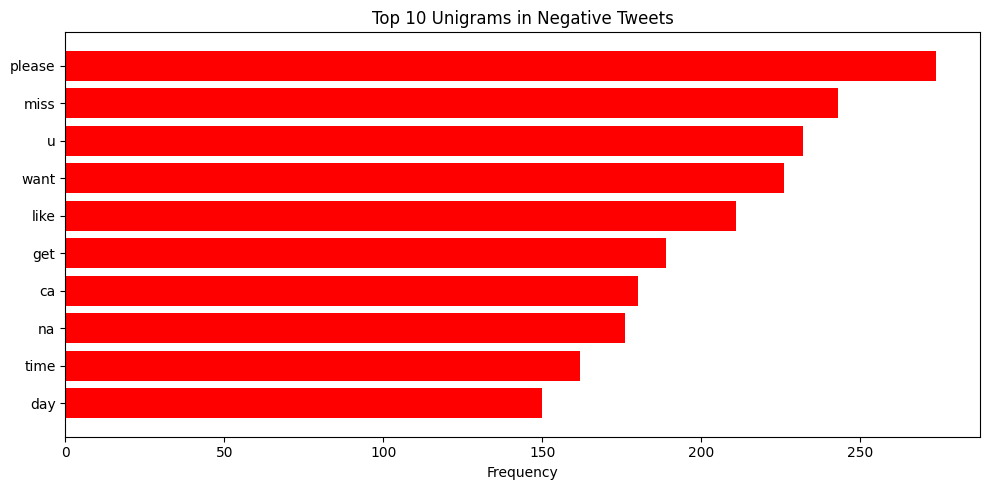

Top 10 Unigrams in Neutral Tweets


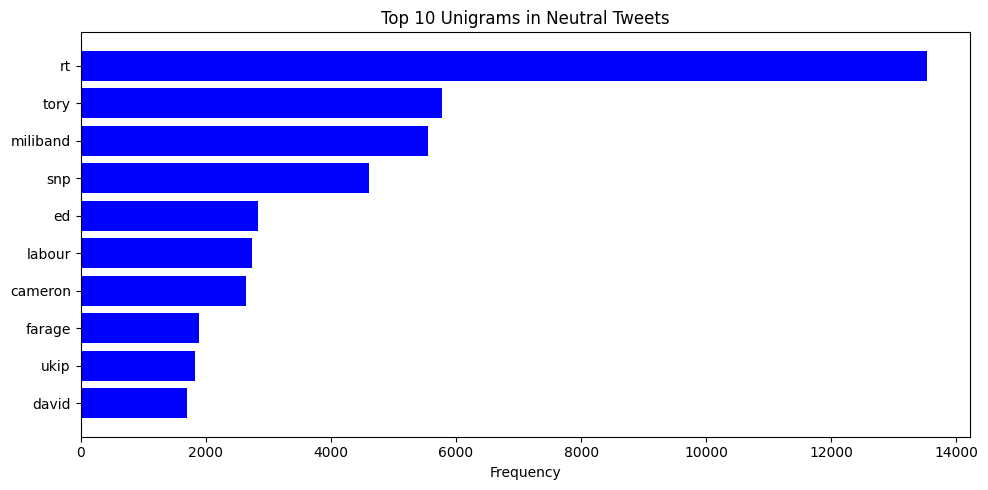


Top 10 Bigrams in Positive Tweets


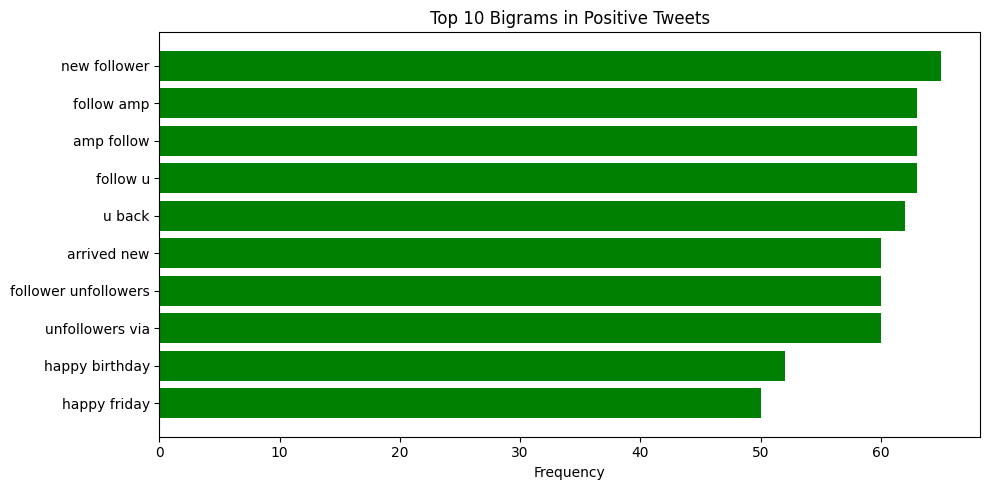

Top 10 Bigrams in Negative Tweets


<ipython-input-49-f5a40ea3b1d9>:24: UserWarning: Glyph 65357 (\N{FULLWIDTH LATIN SMALL LETTER M}) missing from current font.
  plt.tight_layout()
<ipython-input-49-f5a40ea3b1d9>:24: UserWarning: Glyph 65349 (\N{FULLWIDTH LATIN SMALL LETTER E}) missing from current font.
  plt.tight_layout()
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 65357 (\N{FULLWIDTH LATIN SMALL LETTER M}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 65349 (\N{FULLWIDTH LATIN SMALL LETTER E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


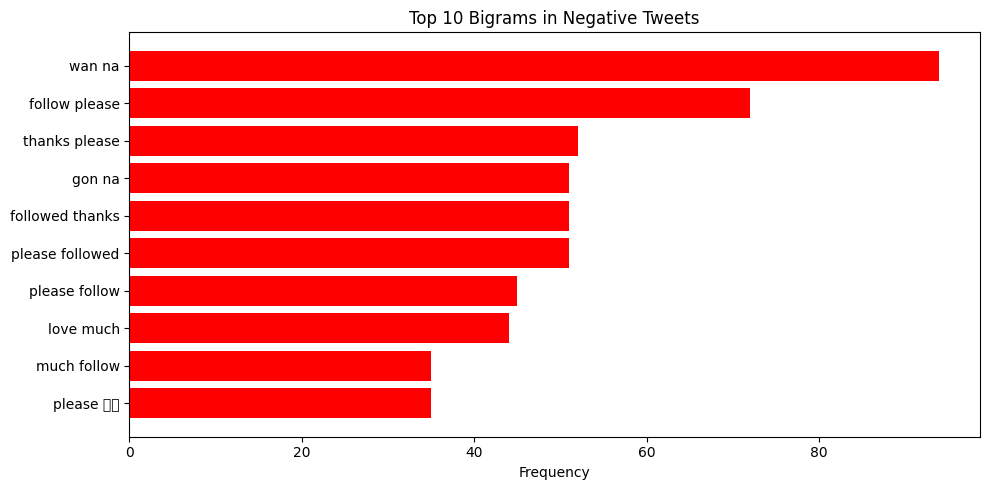

Top 10 Bigrams in Neutral Tweets


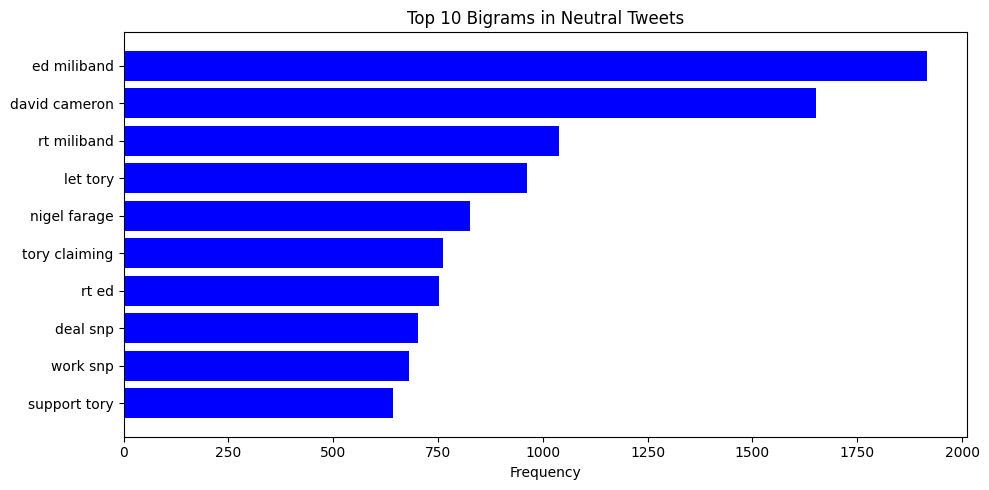


Top 10 Trigrams in Positive Tweets


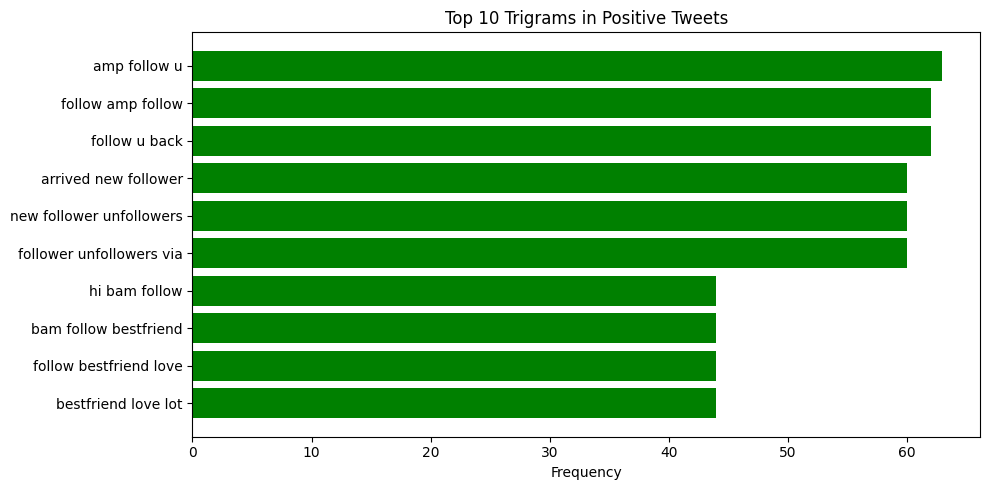

Top 10 Trigrams in Negative Tweets


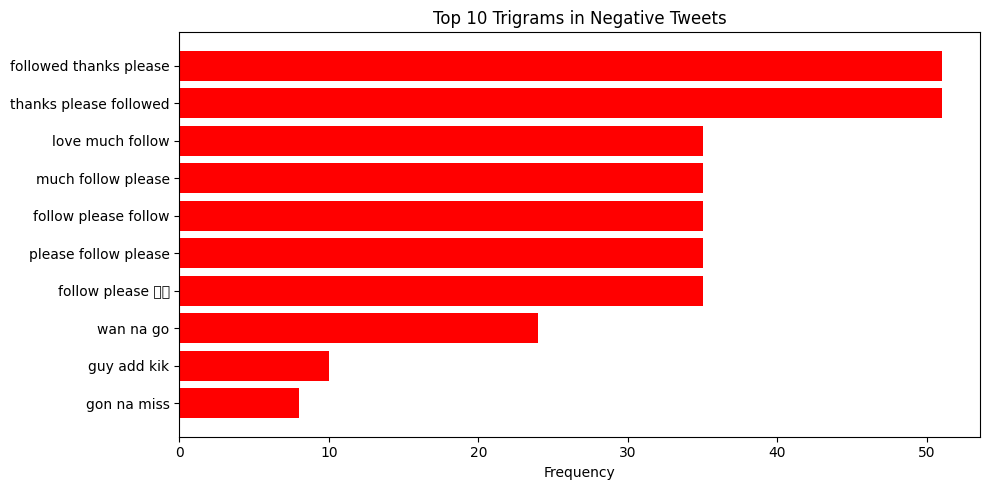

Top 10 Trigrams in Neutral Tweets


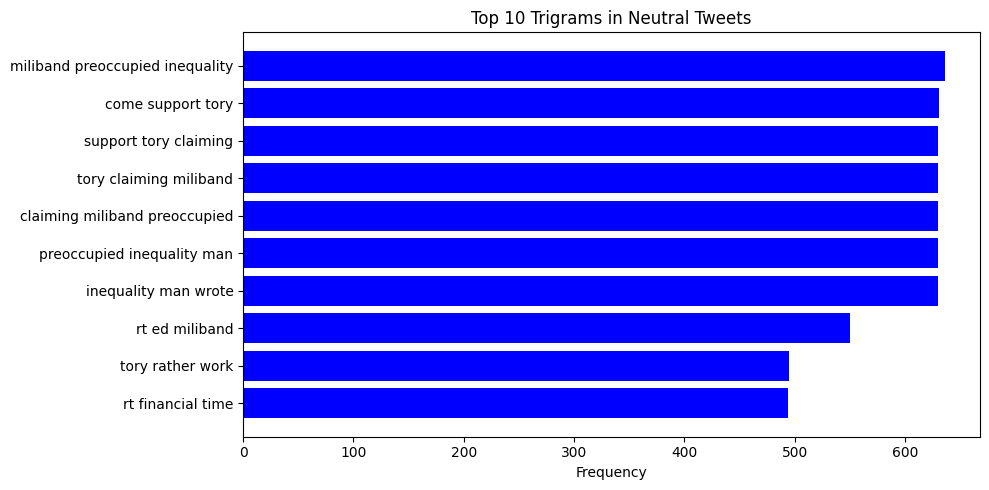

In [ ]:
# Select the top 10 most frequent unigrams for each category
top_10_positive_unigrams = sorted_positive_unigrams[:10]
top_10_negative_unigrams = sorted_negative_unigrams[:10]
top_10_neutral_unigrams = sorted_neutral_unigrams[:10]

# Select the top 10 most frequent bigrams for each category
top_10_positive_bigrams = sorted_positive_bigrams[:10]
top_10_negative_bigrams = sorted_negative_bigrams[:10]
top_10_neutral_bigrams = sorted_neutral_bigrams[:10]

# Select the top 10 most frequent trigrams for each category
top_10_positive_trigrams = sorted_positive_trigrams[:10]
top_10_negative_trigrams = sorted_negative_trigrams[:10]
top_10_neutral_trigrams = sorted_neutral_trigrams[:10]

# Function to plot with specified colors for each category
def plot_ngrams(ngrams, title, color):
    labels, values = zip(*ngrams)  # Unpack the n-grams and their frequencies
    plt.figure(figsize=(10, 5))
    plt.barh([' '.join(gram) for gram in labels], values, color=color)  # Plot the n-grams with the specified color
    plt.xlabel('Frequency')
    plt.title(title)
    plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent on top
    plt.tight_layout()
    plt.show()

# Plot the top 10 unigrams, bigrams, and trigrams for positive, negative, and neutral tweets

# Unigrams with specified colors
print("Top 10 Unigrams in Positive Tweets")
plot_ngrams(top_10_positive_unigrams, "Top 10 Unigrams in Positive Tweets", "green")

print("Top 10 Unigrams in Negative Tweets")
plot_ngrams(top_10_negative_unigrams, "Top 10 Unigrams in Negative Tweets", "red")

print("Top 10 Unigrams in Neutral Tweets")
plot_ngrams(top_10_neutral_unigrams, "Top 10 Unigrams in Neutral Tweets", "blue")

# Bigrams with specified colors
print("\nTop 10 Bigrams in Positive Tweets")
plot_ngrams(top_10_positive_bigrams, "Top 10 Bigrams in Positive Tweets", "green")

print("Top 10 Bigrams in Negative Tweets")
plot_ngrams(top_10_negative_bigrams, "Top 10 Bigrams in Negative Tweets", "red")

print("Top 10 Bigrams in Neutral Tweets")
plot_ngrams(top_10_neutral_bigrams, "Top 10 Bigrams in Neutral Tweets", "blue")

# Trigrams with specified colors
print("\nTop 10 Trigrams in Positive Tweets")
plot_ngrams(top_10_positive_trigrams, "Top 10 Trigrams in Positive Tweets", "green")

print("Top 10 Trigrams in Negative Tweets")
plot_ngrams(top_10_negative_trigrams, "Top 10 Trigrams in Negative Tweets", "red")

print("Top 10 Trigrams in Neutral Tweets")
plot_ngrams(top_10_neutral_trigrams, "Top 10 Trigrams in Neutral Tweets", "blue")
